In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import folium
from folium.plugins import MarkerCluster
import plotly.express as px

In [2]:
data = pd.read_csv('globalterrorism.csv', encoding = 'Latin')
data.head()

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.



,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,...,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination,NaN,NaN,NaN,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,Julio Guzman,...,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,North America,Federal,Mexico city,19.371887,-99.086624,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,6,Hostage Taking (Kidnapping),NaN,NaN,NaN,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, cons...",Belgian Ambassador Daughter,"Nadine Chaval, daughter",...,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,1.0,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,800000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,4.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination,NaN,NaN,NaN,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voice of America,Employee,...,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,Western Europe,Attica,Athens,37.997490,23.762728,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,3,Bombing/Explosion,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Embassy,...,NaN,NaN,Explosive,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,East Asia,Fukouka,Fukouka,33.580412,130.396361,1.0,0,NaN,NaN,1,1,1,-9.0,NaN,NaN,0.0,1,0,7,Facility/Infrastructure Attack,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Consulate,...,NaN,NaN,Incendiary,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [4]:
data.shape

(181691, 135)

In [5]:
data.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,alternative,multiple,success,suicide,attacktype1,attacktype2,attacktype3,targtype1,targsubtype1,natlty1,targtype2,targsubtype2,natlty2,targtype3,targsubtype3,natlty3,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claim2,claimmode2,claim3,claimmode3,compclaim,weaptype1,weapsubtype1,weaptype2,weapsubtype2,weaptype3,weapsubtype3,weaptype4,weapsubtype4,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propvalue,ishostkid,nhostkid,nhostkidus,nhours,ndays,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,181691.000000,181691.000000,181691.000000,181691.000000,181690.000000,29011.000000,181690.000000,181691.000000,181691.000000,181691.000000,6314.000000,428.000000,181691.000000,171318.000000,180132.000000,11144.000000,10685.000000,10828.000000,1176.000000,1097.000000,1147.000000,181311.000000,1955.000000,320.000000,181691.000000,110576.000000,112202.000000,115571.000000,19083.000000,1890.000000,616.000000,318.000000,133.000000,4839.000000,181691.000000,160923.000000,13127.000000,11542.000000,1863.000000,1693.000000,73.000000,70.000000,171378.000000,117245.000000,114733.000000,165380.000000,116989.000000,112548.000000,181691.000000,64065.000000,3.898900e+04,181513.000000,13572.000000,13517.000000,4063.000000,8124.000000,77381.000000,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,0.068297,0.988530,0.993093,0.875668,-0.523171,1.292923,0.137773,0.889598,0.036507,3.247547,3.719512,5.245327,8.439719,46.971474,127.686441,10.247218,55.311652,131.179442,10.021259,55.548769,144.564952,0.081440,0.265473,0.193750,0.002950,-65.361154,-1.517727,0.049666,7.022848,0.247619,7.176948,0.411950,6.729323,-6.296342,6.447325,11.117162,6.812524,10.754029,6.911433,11.643237,6.246575,10.842857,2.403272,0.045981,0.508058,3.167668,0.038944,0.107163,-0.544556,3.295403,2.088119e+05,0.059054,4.533230,-0.353999,-46.793933,-32.516371,-0.145811,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,0.284553,0.106483,0.082823,0.329961,2.455819,0.703729,0.344663,0.313391,0.187549,1.915772,2.272023,2.246642,6.653838,30.953357,89.299120,5.709076,25.640310,125.951485,5.723447,26.288955,163.299295,0.273511,0.441698,0.395854,0.054234,216.536633,12.830346,1.093195,2.476851,0.974018,2.783725,0.492962,2.908003,4.234620,2.173435,6.495612,2.277081,7.594574,2.177956,8.493166,1.507212,8.192672,11.545741,5.681854,4.199937,35.949392,3.057361,1.488881,3.122889,0.486912,1.552463e+07,0.461244,202.316386,6.835645,82.800405,121.209205,1.207861,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,-9.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,0.000000,0.000000,0.000000,0.000000,-99.000000,-99.000000,-9.000000,1.000000,-9.000000,1.000000,0.000000,1.000000,-9.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,-9.900000e+01,-9.000000,-99.000000,-99.000000,-99.000000,-99.000000,-9.000000,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000

In [6]:
data.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [7]:
data['affected'] = data['nkill'] + data['nwound']
data['affected'].value_counts()

0.0       63297
1.0       30157
2.0       15278
3.0       10273
4.0        7549
          ...  
312.0         1
1362.0        1
297.0         1
4224.0        1
396.0         1
Name: affected, Length: 341, dtype: int64

In [8]:
data['country_txt'].value_counts()

Iraq                   24636
Pakistan               14368
Afghanistan            12731
India                  11960
Colombia                8306
                       ...  
South Vietnam              1
New Hebrides               1
St. Lucia                  1
Antigua and Barbuda        1
Falkland Islands           1
Name: country_txt, Length: 205, dtype: int64

In [9]:
print("Maximally targetted country is: ", data['natlty1_txt'].value_counts().index[0])
print("Least targetted Country is:", data['natlty1_txt'].value_counts().index[-1])

Maximally targetted country is:  Iraq
Least targetted Country is: Tuvalu


##Data Visualization

In [10]:
print('Maximally preferred type of attacks:', data['attacktype1_txt'].value_counts().index[0])

Maximally preferred type of attacks: Bombing/Explosion


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



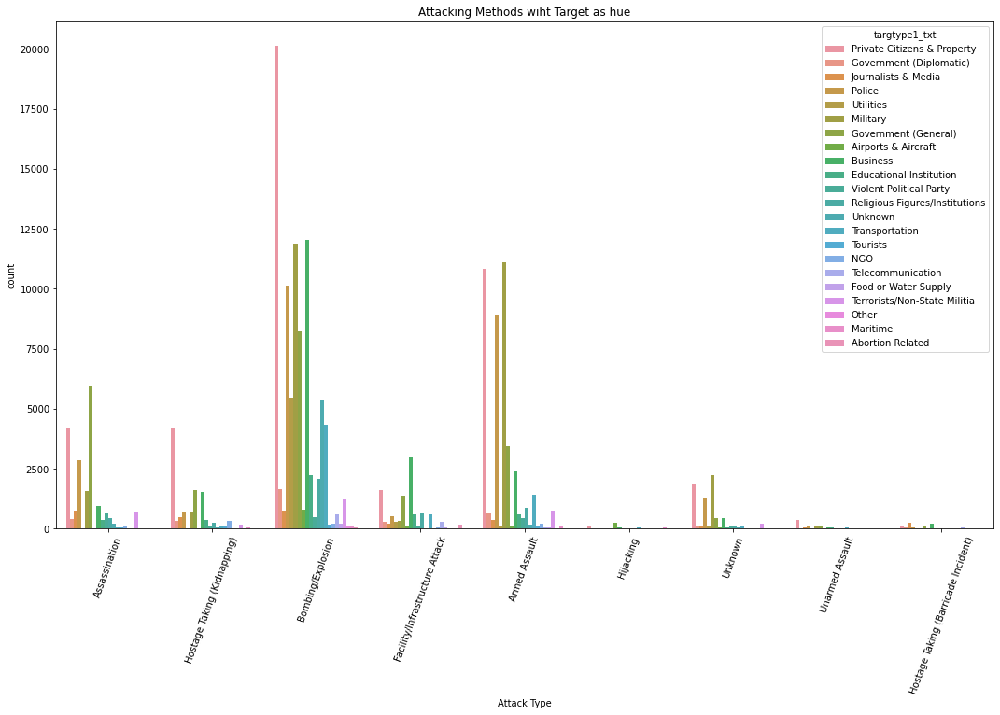

In [11]:
plt.subplots(figsize=(18,10))
sns.countplot('attacktype1_txt', data = data, hue = data['targtype1_txt'])
plt.xticks(rotation=70)
plt.xlabel('Attack Type')
plt.title('Attacking Methods wiht Target as hue')
plt.show()

In [12]:
from collections import Counter

In [13]:
#Type of terrorist attacks
target = list(data['targtype1_txt'])
target_map = dict(Counter(target))
target_df = pd.DataFrame(target_map.items())
target_df.columns = ['targtype1','count']
px.bar(data_frame=target_df,x = 'targtype1',y = 'count',color='targtype1',template='plotly_white')

Private Citizens & Property are highest among all.

In [14]:
print('Year with the most number of attacks is:', data['iyear'].value_counts().index[0])

Year with the most number of attacks is: 2014


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



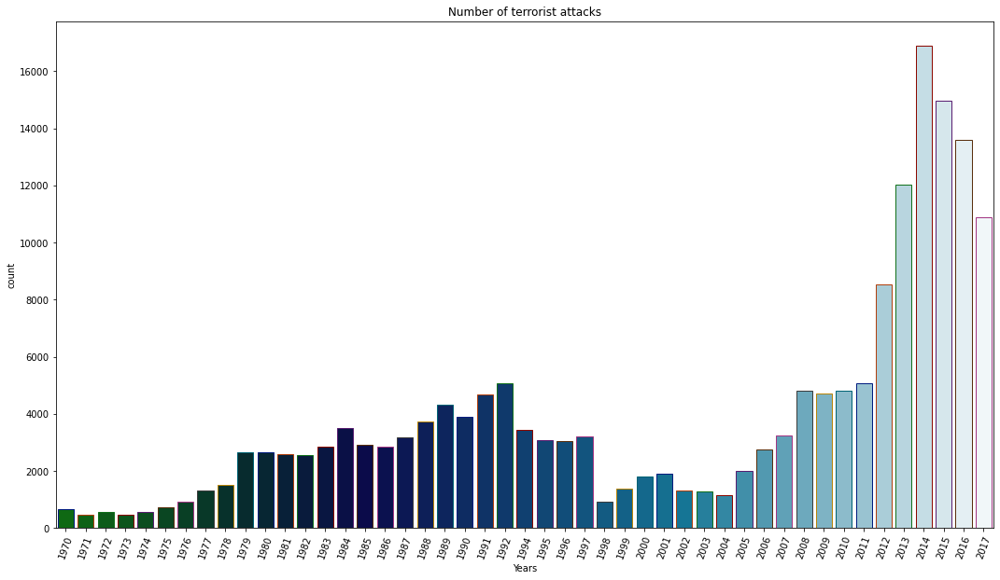

In [15]:
plt.subplots(figsize=(18,10))
sns.countplot('iyear', data = data, palette ='ocean', edgecolor = sns.color_palette('dark'))
plt.xticks(rotation=70)
plt.xlabel('Years')
plt.title('Number of terrorist attacks')
plt.show()

From the above graph we can infer that:


*   The number of terrorist attacks have kept on increasing since 2004.
*   The maximum number of terrorist attacks happened in the year 2014.
*   The terrorists attacks have started to decrease after 2014.



/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



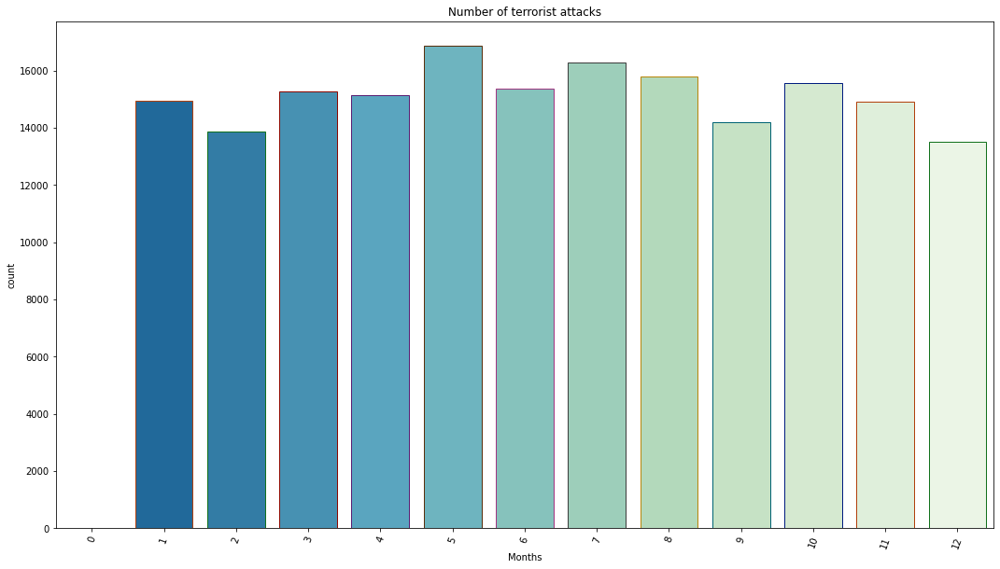

Month with the most number of attacks is: 5


In [16]:
plt.subplots(figsize=(18,10))
sns.countplot('imonth', data = data, palette ='GnBu_r', edgecolor = sns.color_palette('dark'))
plt.xticks(rotation=70)
plt.xlabel('Months')
plt.title('Number of terrorist attacks')
plt.show()
print('Month with the most number of attacks is:', data['imonth'].value_counts().index[0])

**Analysing the type of attack**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



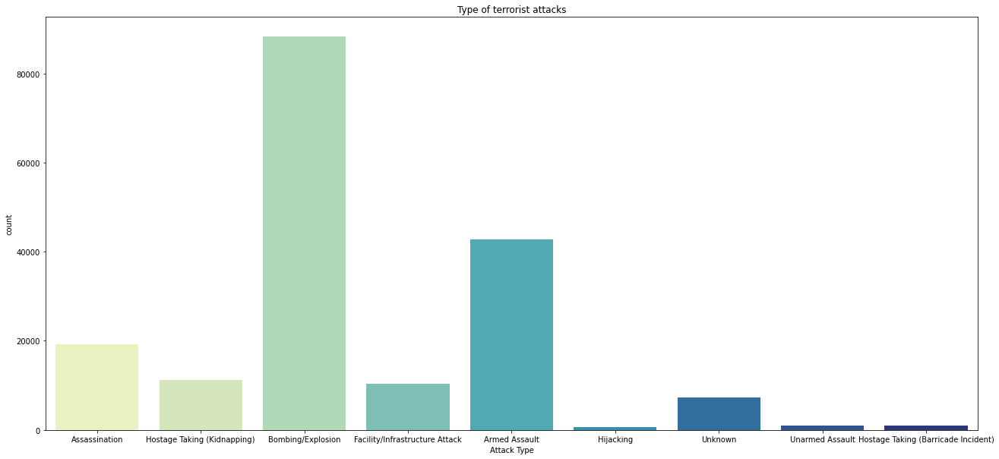

In [17]:
plt.subplots(figsize=(22,10))
sns.countplot('attacktype1_txt', data = data, palette ='YlGnBu')
plt.xticks(rotation=0)
plt.xlabel('Attack Type')
plt.title('Type of terrorist attacks')
plt.show()

In [18]:
#Counting the number of people affected by terrorist attacks
AttackType = data.pivot_table(columns = 'attacktype1_txt', values = 'affected', aggfunc='sum')
AttackType = AttackType.T
AttackType['Type'] = AttackType.index

In [19]:
#Plotting the attack type
labels = AttackType.columns.tolist()
attack = AttackType.T
values = attack.values.tolist()
values = sum(values, [])
attack_type = list(data['attacktype1_txt'].unique())
fig = go.Figure(data=[go.Pie(labels = attack_type,values=values,hole=.3)])
fig.update_layout(template = 'gridon')
fig.show()

From the above graphs we observe that Bombing/Explosion are the maximum chosen type.

In [20]:
df = data.sort_values(by = 'affected', ascending=False)[:20]
df

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,...,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related,affected
73127,200109110005,2001,9,11,NaN,0,NaN,217,United States,1,North America,New York,New York City,40.697132,-73.931351,1.0,0,NaN,09/11/2001: This was one of four related attac...,1,1,1,0.0,NaN,NaN,1.0,1,1,4,Hijacking,2.0,Armed Assault,NaN,NaN,14,Private Citizens & Property,67.0,Unnamed Civilian/Unspecified,Civilians,Passengers and crew members on United Airlines...,...,NaN,The attackers reportedly gained control of the...,1383.0,1327.0,5.0,8191.0,NaN,0.0,1,1.0,Catastrophic (likely >= $1 billion),NaN,The crash resulted in the destruction of an Un...,1.0,59.0,54.0,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,4.0,Hostage(s) killed (not during rescue attempt),0.0,This attack was one of four related incidents ...,"United States Government, The 9/11 Commission ...","Lindsay Kines, United States on high alert af...","Joe Frolick, Hijackers Ram Two Airliners Into...",CETIS,0,1,0,1,"200109110005, 200109110004, 200109110006, 2001...",9574.0
73126,200109110004,2001,9,11,NaN,0,NaN,217,United States,1,North America,New York,New York City,40.697132,-73.931351,1.0,0,NaN,09/11/2001: This was one of four related attac...,1,1,1,0.0,NaN,NaN,1.0,1,1,4,Hijacking,2.0,Armed Assault,NaN,NaN,14,Private Citizens & Property,67.0,Unnamed Civilian/Unspecified,Civilians,Passengers and crew members on American Airlin...,...,NaN,The attackers reportedly gained control of the...,1384.0,1360.0,5.0,8190.0,NaN,0.0,1,1.0,Catastrophic (likely >= $1 billion),NaN,The crash resulted in the destruction of an Am...,1.0,88.0,86.0,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,4.0,Hostage(s) killed (not during rescue attempt),0.0,This attack was one of four related incidents ...,"United States Government, The 9/11 Commission ...","Lindsay Kines, United States on high alert af...","Joe Frolick, Hijackers Ram Two Airliners Into...",CETIS,0,1,0,1,"200109110004, 200109110005, 200109110006, 2001...",9574.0
58841,199503200014,1995,3,20,NaN,0,NaN,101,Japan,4,East Asia,Tokyo,Tokyo,35.689125,139.747742,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,8,Unarmed Assault,NaN,NaN,NaN,NaN,19,Transportation,102.0,Subway,gov't,Subway system,...,NaN,Sarin,13.0,NaN,NaN,5500.0,3.0,NaN,1,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN,5513.0
68071,199808070002,1998,8,7,NaN,0,NaN,104,Kenya,11,Sub-Saharan Africa,Nairobi,Nairobi,-1.285180,36.821107,1.0,0,NaN,08/07/1998: Suicide attackers detonated a vehi...,1,1,1,0.0,NaN,NaN,1.0,1,1,3,Bombing/Explosion,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,U.S. Department of State,"United States Embassy in Nairobi, Kenya",...,NaN,NaN,224.0,12.0,1.0,4000.0,NaN,0.0,1,2.0,Major (likely >= $1 million but < $1 billion),NaN,The damage to both the Nairobi and the Dar es ...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Laura Myers, U.S. promises to hit back if any...","Kenya; New Twist in bomb Tragedy, Africa New...","Blast toll tops 200, Evening Herald (Plymout...",CETIS,0,1,1,1,"199808070002, 199808070003",4224.0
159773,201603080001,2016,3,9,NaN,0,NaN,95,Iraq,10,Middle East & North Africa,Kirkuk,Taza Khurmatu,35.303047,44.329933,1.0,0,NaN,03/09/2016: Assailants fired 60 rockets hol

In [21]:
heat = df.pivot_table(index='country_txt', columns = 'iyear', values='affected')
heat.fillna(0, inplace = True)

In [22]:
heat.head()

iyear,1982,1984,1992,1994,1995,1996,1998,2001,2004,2005,2006,2007,2008,2016,2017
country_txt,,,,,,,,,,,,,,,
Chad,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1161.0,0.0,0.0
India,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1005.0,0.0,0.0,0.0,0.0
Iran,760.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Iraq,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,702.0,0.0,1000.0,0.0,1503.0,0.0
Japan,0.0,0.0,0.0,0.0,5513.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Text(0.5, 1.0, 'Heatmap for attacked with respect to coutry and year')

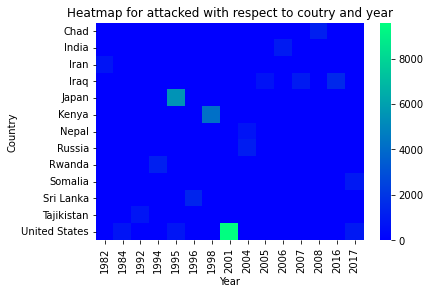

In [23]:
sns.heatmap(data = heat, cmap='winter')
plt.xlabel('Year')
plt.ylabel('Country')
plt.title('Heatmap for attacked with respect to coutry and year')

In [24]:
data['targtype1_txt'].value_counts()

Private Citizens & Property       43511
Military                          27984
Police                            24506
Government (General)              21283
Business                          20669
Transportation                     6799
Utilities                          6023
Unknown                            5898
Religious Figures/Institutions     4440
Educational Institution            4322
Government (Diplomatic)            3573
Terrorists/Non-State Militia       3039
Journalists & Media                2948
Violent Political Party            1866
Airports & Aircraft                1343
Telecommunication                  1009
NGO                                 970
Tourists                            440
Maritime                            351
Food or Water Supply                317
Abortion Related                    263
Other                               137
Name: targtype1_txt, dtype: int64

In [25]:
print("Maximally Targetted: ", df['targtype1_txt'].value_counts().index[0])

Maximally Targetted:  Private Citizens & Property


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



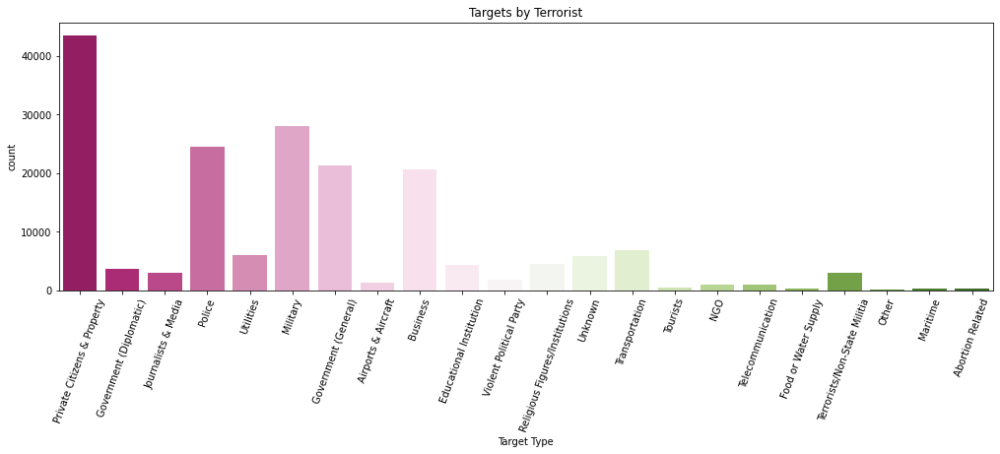

In [26]:
plt.subplots(figsize=(17,5))
sns.countplot('targtype1_txt', data = data, palette = 'PiYG')
plt.xlabel('Target Type')
plt.xticks(rotation=70)
plt.title('Targets by Terrorist')
plt.show()

**Top 15 Countries showing the highest number of terrorist attacks**

In [27]:
df['country_txt'].value_counts().index[:20]

Index(['United States', 'Iraq', 'Sri Lanka', 'Nepal', 'Rwanda', 'Somalia',
       'Tajikistan', 'Kenya', 'India', 'Russia', 'Chad', 'Iran', 'Japan'],
      dtype='object')

**Plotting hot zone of terrorism on the highest year of Terrorist Attack(2014)**

In [28]:
year = data[data['iyear'] == 2014]
mapData = year.loc[:,'city':'longitude']
mapData=mapData.dropna().values.tolist()

map = folium.Map(location = [0, 50], tiles='CartoDB positron', zoom_start=2) 
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(mapData)):
    folium.Marker(location=[mapData[point][1],mapData[point][2]],
                  popup = mapData[point][0]).add_to(markerCluster)
map

In [29]:
print("Maximally targetted country: ", data['country_txt'].value_counts().index[0])

Maximally targetted country:  Iraq


In [30]:
plt.figure(figsize=(15,6))
country_attack=data.country_txt.value_counts()[:15].reset_index()
country_attack.columns= ["country_txt", "Total Attacks"]
px.bar(data_frame= country_attack,x = 'country_txt',y = 'Total Attacks',color = 'country_txt',template='plotly_white')

<Figure size 1080x432 with 0 Axes>

Iraq has the highest number of terrorist attacks followed by Pakistan, Afghanistan and India.

**Counting the total number of people affected as per country**

In [31]:
plt.figure(figsize=(15, 8))
cas_count= data.groupby("country_txt").affected.sum().to_frame().reset_index().sort_values("affected", ascending=False)[:15]
px.bar(data_frame=cas_count,x = 'country_txt',y = 'affected',color='country_txt')

<Figure size 1080x576 with 0 Axes>

**Subtargets by terrorists**

In [32]:
data['targsubtype1_txt'].value_counts().index[:20]

Index(['Unnamed Civilian/Unspecified', 'Police Security Forces/Officers',
       'Military Unit/Patrol/Convoy',
       'Military Personnel (soldiers, troops, officers, forces)',
       'Government Personnel (excluding police, military)',
       'Village/City/Town/Suburb',
       'Politician or Political Party Movement/Meeting/Rally',
       'Police Building (headquarters, station, school)',
       'Military Barracks/Base/Headquarters/Checkpost',
       'Police Patrol (including vehicles and convoys)',
       'Government Building/Facility/Office', 'Retail/Grocery/Bakery',
       'Electricity', 'Bank/Commerce', 'House/Apartment/Residence',
       'School/University/Educational Building', 'Vehicles/Transportation',
       'Marketplace/Plaza/Square', 'Bus (excluding tourists)',
       'Place of Worship'],
      dtype='object')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



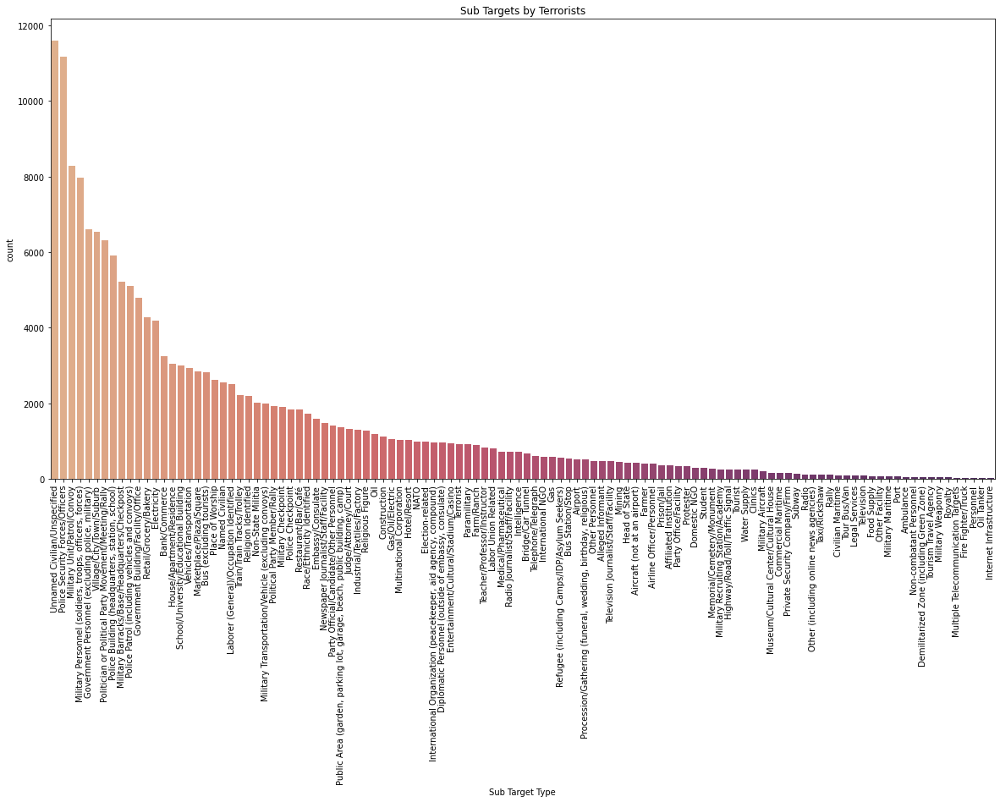

In [33]:
plt.subplots(figsize=(20,10))
sns.countplot('targsubtype1_txt', data = data, palette= 'flare', order = data['targsubtype1_txt'].value_counts().index)
plt.xticks(rotation=90)
plt.xlabel('Sub Target Type')
plt.title('Sub Targets by Terrorists')
plt.show()

**Analyzing with respect to region**

In [34]:
data['region_txt'].value_counts()

Middle East & North Africa     50474
South Asia                     44974
South America                  18978
Sub-Saharan Africa             17550
Western Europe                 16639
Southeast Asia                 12485
Central America & Caribbean    10344
Eastern Europe                  5144
North America                   3456
East Asia                        802
Central Asia                     563
Australasia & Oceania            282
Name: region_txt, dtype: int64

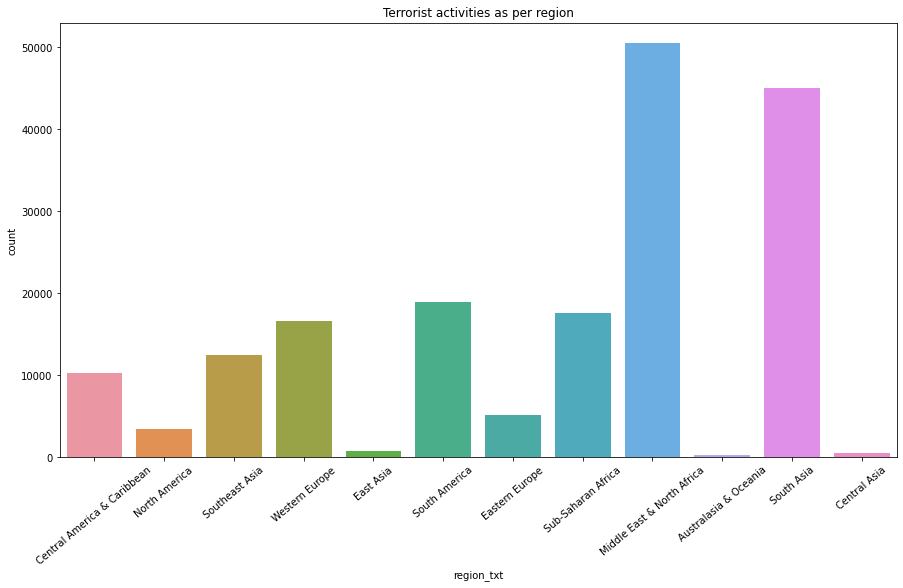

In [35]:
plt.figure(figsize=(15,8))
sns.countplot(x='region_txt', data = data)
plt.xticks(rotation = 40)
plt.title('Terrorist activities as per region')
plt.show()

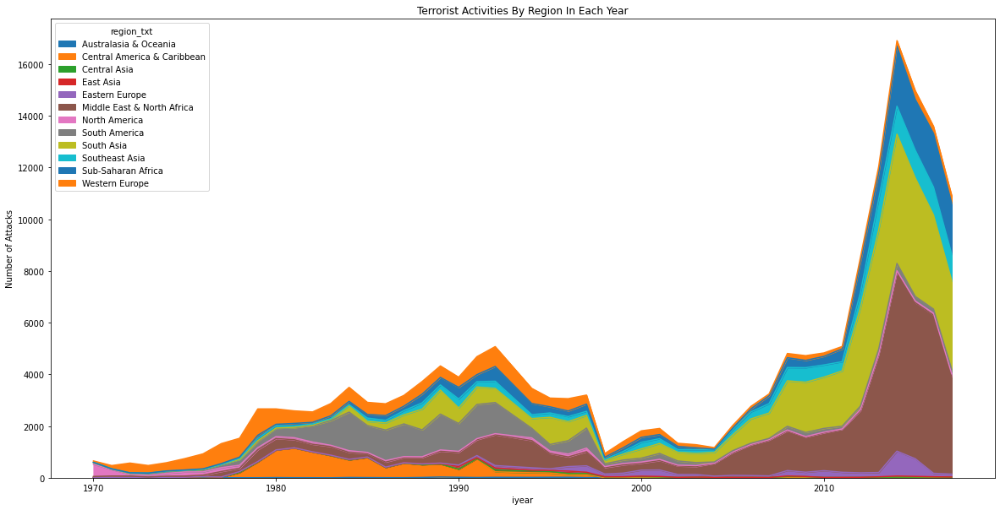

In [36]:
pd.crosstab(data.iyear, data.region_txt).plot(kind = 'area', figsize=(20,10))
plt.title('Terrorist Activities By Region In Each Year')
plt.ylabel('Number of Attacks')
plt.show()

In [37]:
#The number of people affected by terrorists per year
year_cas = data.groupby('iyear').affected.sum().to_frame().reset_index()
year_cas.columns = ['iyear', 'affected']
px.bar(data_frame = year_cas, x='iyear', y='affected', color = 'affected', template = 'plotly_dark')

Terrorists attacked in 2015 affected the maximum number of people

###Thank You!